In [1]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

import matplotlib.pyplot as plt
import numpy as np
import IPython

from PIL import Image, ImageDraw
from random import randrange
    
from torchvision.ops import nms


In [2]:
def draw_cell_boundaries(image, cells=7):
    overlay = Image.new('RGBA', image.size, (0, 0, 0, 0))
    draw = ImageDraw.Draw(image)
    overlay_draw = ImageDraw.Draw(overlay)
    image_width, image_height = image.size
    
    fill_color = (255, 255, 128, 200)
    
    unit = image_width / cells
    for idx in range(1, cells):
        vertical_line_x = unit * idx
        overlay_draw.line([(vertical_line_x, 0), (vertical_line_x, image_height)], fill=fill_color)

    unit = image_height / cells
    for idx in range(1, cells):
        horizontal_line_y = unit * idx
        overlay_draw.line([(0, horizontal_line_y), (image_width, horizontal_line_y)], fill=fill_color)
        
    return Image.alpha_composite(image.convert("RGBA"), overlay).convert("RGB")
        
def draw_center_cell_object(image, annotator, annotation, cells=7):
    image_width, image_height = image.size
    
    fill_color = (255, 0, 0, 255)
    
    for item in annotation:
        (class_id, cell_idx_x, cell_idx_y, cell_pos_x, cell_pos_y, width, height) = item
        overlay = Image.new('RGBA', image.size, (0, 0, 0, 0))
        overlay_draw = ImageDraw.Draw(overlay)

        horizontal_unit = image_width / cells
        vertical_unit = image_height / cells

        class_name = annotator.labels[class_id]

        # draw center cell as red color
        cxmin = horizontal_unit * cell_idx_x
        cxmax = horizontal_unit * (cell_idx_x + 1)
        cymin = vertical_unit * cell_idx_y
        cymax = vertical_unit * (cell_idx_y + 1)
        
        draw = ImageDraw.Draw(image)
        draw.line([(cxmin, cymin), (cxmax, cymin)], fill=fill_color)
        draw.line([(cxmax, cymin), (cxmax, cymax)], fill=fill_color)
        draw.line([(cxmax, cymax), (cxmin, cymax)], fill=fill_color)
        draw.line([(cxmin, cymax), (cxmin, cymin)], fill=fill_color)
        
        cell_obj_center_x = int(cxmin + (cell_pos_x * image_width))
        cell_obj_center_y = int(cymin + (cell_pos_y * image_height))
        
        oxmin, oxmax = int(cell_obj_center_x + (width * image_width / 2)), int(cell_obj_center_x - (width * image_width / 2))
        oymin, oymax = int(cell_obj_center_y + (height * image_height / 2)), int(cell_obj_center_y - (height * image_height / 2))
        
        draw.ellipse([(cell_obj_center_x - 3, cell_obj_center_y - 3), (cell_obj_center_x + 3, cell_obj_center_y + 3)], fill=(255, 0, 0), width=6)
        draw.text((cell_obj_center_x + 8, cell_obj_center_y - 6), "CLSID: %s" % class_name, fill=fill_color)
        
        random_color_r, random_color_g, random_color_b = randrange(255), randrange(255), randrange(255)
        overlay_color = (random_color_r, random_color_g, random_color_b, 90)
        overlay_draw.rectangle([oxmin, oymin, oxmax, oymax], fill=overlay_color)  # draw object in random color
        
        image = Image.alpha_composite(image.convert("RGBA"), overlay).convert("RGB")
        
    return image


# TODO: redesign based on 2 predictor output
# ignore predictor with lower bbox confidence

# model output version of draw_center_cell_object
def draw_center_cell_object_output(image, annotator, output, confidence_threshold=0.3):
    draw = ImageDraw.Draw(image)
    image_width, image_height = image.size
    
    fill_color = (255, 0, 0, 255)
    
    # output -> [30, 7, 7]
    cells = output.shape[1] # 1, 2 indicates cell count
    bboxes = (output.shape[0] - 20) // 5
    assert((output.shape[0] - 20) % 5 == 0) 
    
    # Organize bboxes for NMS algorithm
    bbox_coordinates = []
    bbox_scores = []
    bbox_classes = []
    for cell_idx_y in range(cells):
        for cell_idx_x in range(cells):
            for bbox_idx in range(bboxes):
                current_predictor = output[5 * (bbox_idx):5 * (bbox_idx + 1), cell_idx_y, cell_idx_x]
                (cell_pos_x, cell_pos_y, width, height, confidence) = torch.sigmoid(torch.from_numpy(current_predictor[:5])).numpy()
                class_id = np.argmax(torch.log_softmax(torch.from_numpy(output[-20:, cell_idx_y, cell_idx_x]), dim=0))
                
                if confidence < confidence_threshold:
                    continue
                # print("sigmoided coordinates", np.array([cell_pos_x, cell_pos_y, width, height, confidence]))

                horizontal_unit = image_width / cells
                vertical_unit = image_height / cells
                
                class_name = annotator.labels[class_id]
                obj_center_x = (cell_idx_x + cell_pos_x) / cells
                obj_center_y = (cell_idx_y + cell_pos_y) / cells
                oxmin, oxmax = obj_center_x - (width / 2), obj_center_x + (width / 2)
                oymin, oymax = obj_center_y - (height / 2), obj_center_y + (height / 2)
                
                bbox_coordinates.append([oxmin, oymin, oxmax, oymax])
                bbox_scores.append(confidence)
                bbox_classes.append(class_id)
                
#     print("bbox_coordinates", bbox_coordinates)
#     print("bbox_scores", bbox_scores)
#     print("bbox_classes", bbox_classes)
                
    if len(bbox_coordinates) > 0:
        # print("[Before NMS] BBoxes:", len(bbox_coordinates))

        bbox_coordinates = torch.from_numpy(np.array(bbox_coordinates)).float()
        bbox_scores = torch.from_numpy(np.array(bbox_scores)).float()
        bbox_classes = torch.from_numpy(np.array(bbox_classes)).float()

        coordinates_indicies = nms(boxes=bbox_coordinates, scores=bbox_scores, iou_threshold=0.8)
        
#         bbox_filtered_coordinates = torch.gather(bbox_coordinates, 1, coordinates_indicies)
#         bbox_filtered_scores = torch.gather(bbox_scores, 0, coordinates_indicies)
#         bbox_filtered_classes = torch.gather(bbox_classes, 0, coordinates_indicies)

        bbox_filtered_coordinates = bbox_coordinates.index_select(0, coordinates_indicies)
        bbox_filtered_scores = bbox_scores.index_select(0, coordinates_indicies)
        bbox_filtered_classes = bbox_classes.index_select(0, coordinates_indicies).int()
        
#         print("[After NMS] BBoxes:", len(bbox_filtered_coordinates))

        for idx in range(bbox_filtered_coordinates.shape[0]):
            (xmin, ymin, xmax, ymax) = bbox_filtered_coordinates[idx].numpy()
            confidence = bbox_filtered_scores[idx].numpy()
            class_id = bbox_filtered_classes[idx].numpy()
            
            oxmin, oxmax = max(xmin * image_width, 0), min(xmax * image_width, image_width - 1)
            oymin, oymax = max(ymin * image_height, 0), min(ymax * image_height, image_height - 1)
            
            cell_obj_center_x, cell_obj_center_y = int(oxmin + (oxmax - oxmin) / 2), int(oymin + (oymax - oymin) / 2)

            class_name = annotator.labels[class_id]

            overlay = Image.new('RGBA', image.size, (0, 0, 0, 0))
            overlay_draw = ImageDraw.Draw(overlay)

            draw.ellipse([(cell_obj_center_x - 3, cell_obj_center_y - 3), (cell_obj_center_x + 3, cell_obj_center_y + 3)], fill=(255, 0, 0), width=6)
            
            draw.text((cell_obj_center_x + 8, cell_obj_center_y - 6), "CLSID: %s" % class_name, fill=fill_color)

            random_color_r, random_color_g, random_color_b = randrange(255), randrange(255), randrange(255)
            overlay_color = (random_color_r, random_color_g, random_color_b, 90)
            overlay_draw.rectangle([oxmin, oymin, oxmax, oymax], fill=overlay_color)  # draw object in random color

            image = Image.alpha_composite(image.convert("RGBA"), overlay).convert("RGB")
        
    return image

# Prepare dataset and training
- Create random 5-image batch and pass it through model.
- We will evaluate loss via result image and intermediate output console

In [3]:
%matplotlib inline

from maintrainer.dataset import VOCYOLOAnnotator, VOCYolo

annotator = VOCYOLOAnnotator(
#     annotation_root=r'C:\Dataset\VOCdevkit\VOC2008\Annotations',
#     image_root=r'C:\Dataset\VOCdevkit\VOC2008\JPEGImages'
    annotation_root='/media/jungin500/windows-10/Dataset/VOCdevkit/VOC2008/Annotations',
    image_root='/media/jungin500/windows-10/Dataset/VOCdevkit/VOC2008/JPEGImages'
)

annotations = annotator.parse_annotation()
print("Annotation[0]:", annotations[0][0])
print("Annotation[1]:", annotations[0][1])

print(annotator.labels)

Annotation 내 Object Names 검색:   0%|          | 0/5096 [00:00<?, ?it/s]

Annotation 검색:   0%|          | 0/5096 [00:00<?, ?it/s]

Annotation[0]: /media/jungin500/windows-10/Dataset/VOCdevkit/VOC2008/JPEGImages/2007_000256.jpg
Annotation[1]: [[0, 3, 3, 0.07042857142857145, 0.0495626822157435, 0.966, 0.3965014577259475]]
['aeroplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus', 'car', 'cat', 'chair', 'cow', 'diningtable', 'dog', 'horse', 'motorbike', 'person', 'pottedplant', 'sheep', 'sofa', 'train', 'tvmonitor']


In [4]:
import torchvision.transforms
from torchvision.transforms import *

train_dataset = VOCYolo(
    annotator.labels,
    annotations,
    transform=transforms.Compose([
        transforms.Resize((448, 448)),
        transforms.ToTensor(),
#         transforms.Normalize(
#             mean=[0.4547857, 0.4349471, 0.40525291],
#             std=[0.12003352, 0.12323549, 0.1392444]
#         )
    ])
)

inline_transform = transforms.Normalize(
    mean=[0.4547857, 0.4349471, 0.40525291],
    std=[0.12003352, 0.12323549, 0.1392444]
)

batch_size = 1
train_dataloader = torch.utils.data.DataLoader(train_dataset, shuffle=False, batch_size=batch_size, num_workers=0, pin_memory=True)

In [5]:
def draw_center_cell_object_label(image, annotator, label):
    image_width, image_height = image.size
    
    fill_color = (255, 0, 0, 255)
    
    # label -> [25, 7, 7]
    cells = label.shape[1] # 1, 2 indicates cell count
    
    for cell_idx_y in range(cells):
        for cell_idx_x in range(cells):
            # ignore predictor with no bbox confidence
            if label[4, cell_idx_y, cell_idx_x] == 0:
                continue
                
            # (class_id, cell_idx_x, cell_idx_y, cell_pos_x, cell_pos_y, width, height) = item
            current_predictor = label[:, cell_idx_y, cell_idx_x]
            (cell_pos_x, cell_pos_y, width, height) = current_predictor[:4]
            class_id = np.argmax(current_predictor[5:])
            
            overlay = Image.new('RGBA', image.size, (0, 0, 0, 0))
            overlay_draw = ImageDraw.Draw(overlay)

            horizontal_unit = image_width / cells
            vertical_unit = image_height / cells

            class_name = annotator.labels[class_id]

            # draw center cell as red color
            cxmin = horizontal_unit * cell_idx_x
            cxmax = horizontal_unit * (cell_idx_x + 1)
            cymin = vertical_unit * cell_idx_y
            cymax = vertical_unit * (cell_idx_y + 1)

            draw = ImageDraw.Draw(image)
            draw.line([(cxmin, cymin), (cxmax, cymin)], fill=fill_color)
            draw.line([(cxmax, cymin), (cxmax, cymax)], fill=fill_color)
            draw.line([(cxmax, cymax), (cxmin, cymax)], fill=fill_color)
            draw.line([(cxmin, cymax), (cxmin, cymin)], fill=fill_color)

            cell_obj_center_x = int(cxmin + (cell_pos_x * image_width))
            cell_obj_center_y = int(cymin + (cell_pos_y * image_height))

            oxmin, oxmax = int(cell_obj_center_x + (width * image_width / 2)), int(cell_obj_center_x - (width * image_width / 2))
            oymin, oymax = int(cell_obj_center_y + (height * image_height / 2)), int(cell_obj_center_y - (height * image_height / 2))

            draw.ellipse([(cell_obj_center_x - 3, cell_obj_center_y - 3), (cell_obj_center_x + 3, cell_obj_center_y + 3)], fill=(255, 0, 0), width=6)
            draw.text((cell_obj_center_x + 8, cell_obj_center_y - 6), "CLSID: %s" % class_name, fill=fill_color)

            random_color_r, random_color_g, random_color_b = 255, 255, 255
            overlay_color = (random_color_r, random_color_g, random_color_b, 90)
            overlay_draw.rectangle([oxmin, oymin, oxmax, oymax], fill=None, outline=(0, 0, 255), width=2)  # draw object in random color

            image = Image.alpha_composite(image.convert("RGBA"), overlay).convert("RGB")
        
    return image

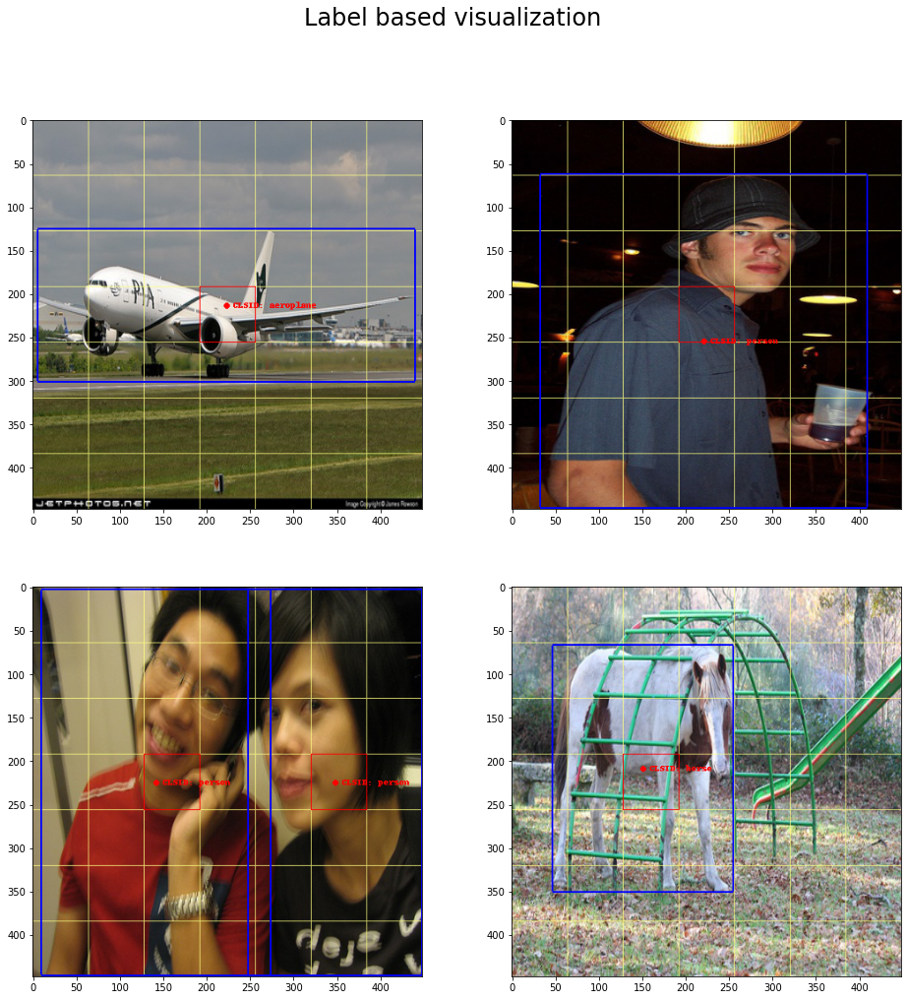

In [6]:
bunch_of_batch = []
for i, item in enumerate(train_dataloader):
    if i >= 4:
        break
    bunch_of_batch.append(item)

fig = plt.figure(figsize=(16, 16))
fig.suptitle("Label based visualization", fontsize=24)
for i, (image, label) in enumerate(bunch_of_batch):
    ax = fig.add_subplot(2, 2, i + 1)
    image = torch.squeeze(image[:1, :, :, :])
    label = torch.squeeze(label[:1, :, :, :])
    
    image = (image.cpu().numpy().transpose((1, 2, 0)) * 255).astype(np.uint8)
    label = label.cpu().numpy()
    
    image = Image.fromarray(image)
    image = draw_cell_boundaries(image)
    image = draw_center_cell_object_label(image, annotator, label)
    ax.imshow(np.array(image))
    
plt.show()

In [7]:
def do_visualization(title = None, confidence_threshold = 0.8):
    fig = plt.figure(figsize=(20, 20))
    fig.suptitle("Output based visualization" if title is None else title, fontsize=24)
    
    model.eval()
    with torch.no_grad():
        batched_image = torch.cat([image[:1, :, :, :].cuda(non_blocking=True) for image, label in bunch_of_batch], 0)
        batched_label = torch.cat([label[:1, :, :, :] for image, label in bunch_of_batch], 0)

        output = model(batched_image).detach().cpu()
        output_images = []
        for i in range(output.shape[0]):
            output_images.append(output[i:i+1, :, :, :])

        for i, output in enumerate(output_images):
            ax = fig.add_subplot(2, 2, i + 1)

            image = torch.squeeze(batched_image[i].cpu())
            output = torch.squeeze(output)

            image = (image.numpy().transpose((1, 2, 0)) * 255).astype(np.uint8)
            output = output.numpy()

            image = Image.fromarray(image)
            image = draw_cell_boundaries(image)
            image = draw_center_cell_object_output(image, annotator, output, confidence_threshold=confidence_threshold)
            ax.imshow(np.array(image))
        plt.show()
    model.train()


In [8]:
from maintrainer.loss import YoloLoss
from model import YOLOv1, YOLOv1Pretrainer
import random
import os

# PRETRAINED_WEIGHT = r'C:\Workspace\study-projects\yolov1-torch\prepare-torch\.pretrained\2021-06-16-10-44-40_FullDataset-LRDecay-Continued-From-22epoch-LowerLR_LR0.000250_BS064_WORKERS16_EPOCHS200_GPU-epoch0043-train_loss1.512860-val_loss1.674705-val_acc0.616029-val_acct50.832321.zip'
PRETRAINED_WEIGHT = '.checkpoints/2021-06-16-10-44-40_FullDataset-LRDecay-Continued-From-22epoch-LowerLR_LR0.000250_BS064_WORKERS16_EPOCHS200_GPU-epoch0043-train_loss1.512860-val_loss1.674705-val_acc0.616029-val_acct50.832321.zip'

if not os.path.isfile(PRETRAINED_WEIGHT):
    print("Pretrained weight file %s not found!" % args.pretrained)
    exit(-1)

checkpoint = torch.load(PRETRAINED_WEIGHT)
# c_epoch = checkpoint['epoch'] + 1
c_model_state_dict = checkpoint['model_state_dict']
# c_optimizer_state_dict = checkpoint['optimizer_state_dict']
# c_loss = checkpoint['loss']

pretrainer = YOLOv1Pretrainer(classes=1000)
pretrainer.load_state_dict(c_model_state_dict)
model = YOLOv1(pretrainer).cuda().float()
del pretrainer

YOLOv1: Loaded pretrained weights from Pretrainer
YOLOv1: Disabled pretrained parameter gradients


NewYoloLossV9 (CUDA not supported for now)
torch.Size([4, 3, 448, 448])
torch.Size([4, 25, 7, 7])


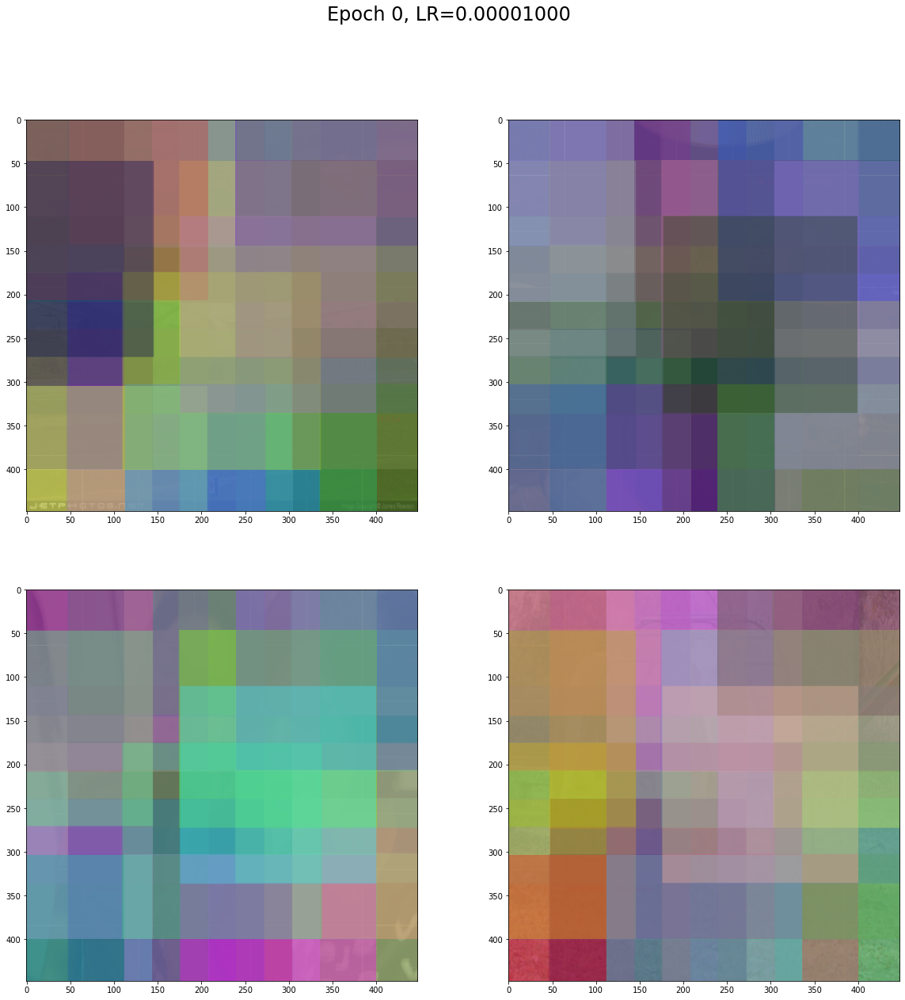

Epoch 0: Loss 89.737869 Acc 0.000000 AccT5 0.200000
Epoch 1: Loss 87.449005 Acc 0.600000 AccT5 1.000000
Epoch 2: Loss 85.224762 Acc 0.800000 AccT5 1.000000
Epoch 3: Loss 82.617195 Acc 0.800000 AccT5 1.000000
Epoch 4: Loss 79.400009 Acc 0.800000 AccT5 1.000000
Epoch 5: Loss 75.489975 Acc 0.800000 AccT5 1.000000
Epoch 6: Loss 70.890015 Acc 0.800000 AccT5 1.000000
Epoch 7: Loss 65.638390 Acc 0.800000 AccT5 1.000000
Epoch 8: Loss 59.740490 Acc 0.800000 AccT5 1.000000
Epoch 9: Loss 53.173141 Acc 0.800000 AccT5 1.000000
Epoch 10: Loss 45.963142 Acc 0.800000 AccT5 1.000000
Epoch 11: Loss 38.229614 Acc 0.800000 AccT5 1.000000
Epoch 12: Loss 30.460697 Acc 0.600000 AccT5 1.000000
Epoch 13: Loss 23.733536 Acc 0.600000 AccT5 0.800000
Epoch 14: Loss 19.428869 Acc 0.600000 AccT5 0.800000
Epoch 15: Loss 17.670090 Acc 0.600000 AccT5 0.600000
Epoch 16: Loss 15.765736 Acc 0.600000 AccT5 0.600000
Epoch 17: Loss 15.902328 Acc 0.200000 AccT5 0.600000
Epoch 18: Loss 15.448256 Acc 0.400000 AccT5 0.600000
Epo

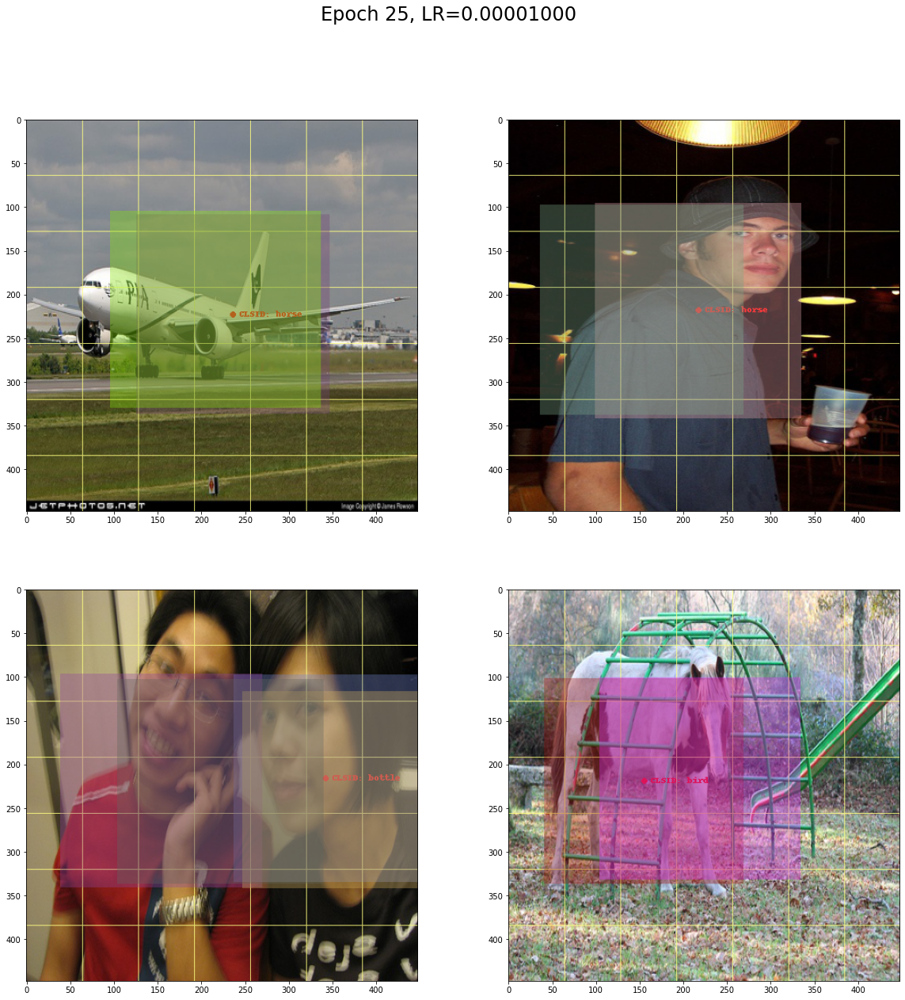

Epoch 25: Loss 12.632509 Acc 0.400000 AccT5 0.600000
Epoch 26: Loss 13.014720 Acc 0.200000 AccT5 0.600000
Epoch 27: Loss 12.826860 Acc 0.200000 AccT5 0.600000
Epoch 28: Loss 12.375854 Acc 0.200000 AccT5 0.600000
Epoch 29: Loss 12.525724 Acc 0.200000 AccT5 0.600000
Epoch 30: Loss 12.426847 Acc 0.000000 AccT5 0.600000
Epoch 31: Loss 11.988171 Acc 0.000000 AccT5 0.600000
Epoch 32: Loss 11.711054 Acc 0.200000 AccT5 0.600000
Epoch 33: Loss 11.842129 Acc 0.400000 AccT5 0.600000
Epoch 34: Loss 11.867764 Acc 0.400000 AccT5 0.600000
Epoch 35: Loss 11.542759 Acc 0.400000 AccT5 0.600000
Epoch 36: Loss 11.465612 Acc 0.200000 AccT5 0.600000
Epoch 37: Loss 11.447515 Acc 0.200000 AccT5 0.600000
Epoch 38: Loss 11.308167 Acc 0.200000 AccT5 0.600000
Epoch 39: Loss 11.234562 Acc 0.200000 AccT5 0.600000
Epoch 40: Loss 11.269733 Acc 0.200000 AccT5 0.600000
Epoch 41: Loss 11.245050 Acc 0.200000 AccT5 0.600000
Epoch 42: Loss 11.103507 Acc 0.200000 AccT5 0.600000
Epoch 43: Loss 11.002975 Acc 0.200000 AccT5 0.

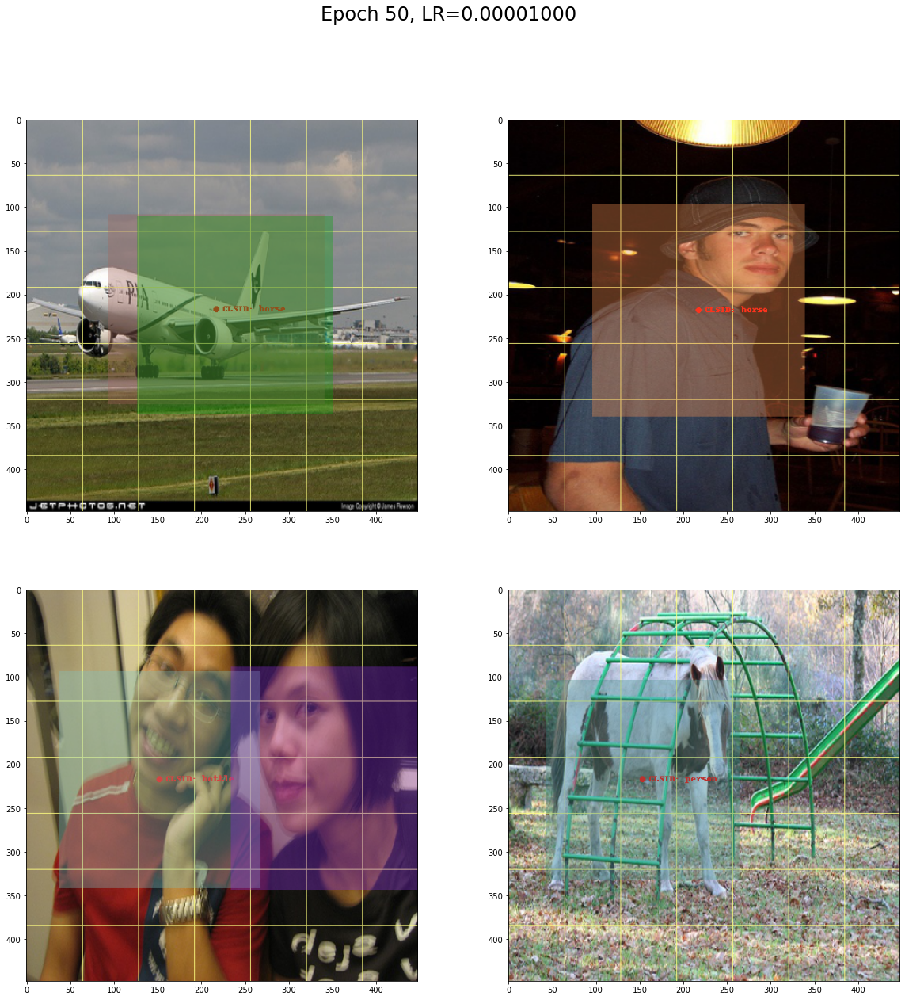

Epoch 50: Loss 10.872591 Acc 0.200000 AccT5 0.600000
Epoch 51: Loss 10.820123 Acc 0.200000 AccT5 0.600000
Epoch 52: Loss 10.822817 Acc 0.200000 AccT5 0.600000
Epoch 53: Loss 10.828382 Acc 0.200000 AccT5 0.600000
Epoch 54: Loss 10.793681 Acc 0.200000 AccT5 0.600000
Epoch 55: Loss 10.753152 Acc 0.200000 AccT5 0.600000
Epoch 56: Loss 10.755102 Acc 0.200000 AccT5 0.600000
Epoch 57: Loss 10.747932 Acc 0.400000 AccT5 0.600000
Epoch 58: Loss 10.727213 Acc 0.400000 AccT5 0.600000
Epoch 59: Loss 10.719067 Acc 0.200000 AccT5 0.600000
Epoch 60: Loss 10.718645 Acc 0.200000 AccT5 0.600000
Epoch 61: Loss 10.697904 Acc 0.200000 AccT5 0.600000
Epoch 62: Loss 10.677591 Acc 0.200000 AccT5 0.600000
Epoch 63: Loss 10.675827 Acc 0.200000 AccT5 0.600000
Epoch 64: Loss 10.683059 Acc 0.200000 AccT5 0.600000
Epoch 65: Loss 10.667328 Acc 0.200000 AccT5 0.600000
Epoch 66: Loss 10.651012 Acc 0.200000 AccT5 0.600000
Epoch 67: Loss 10.650805 Acc 0.200000 AccT5 0.600000
Epoch 68: Loss 10.644971 Acc 0.200000 AccT5 0.

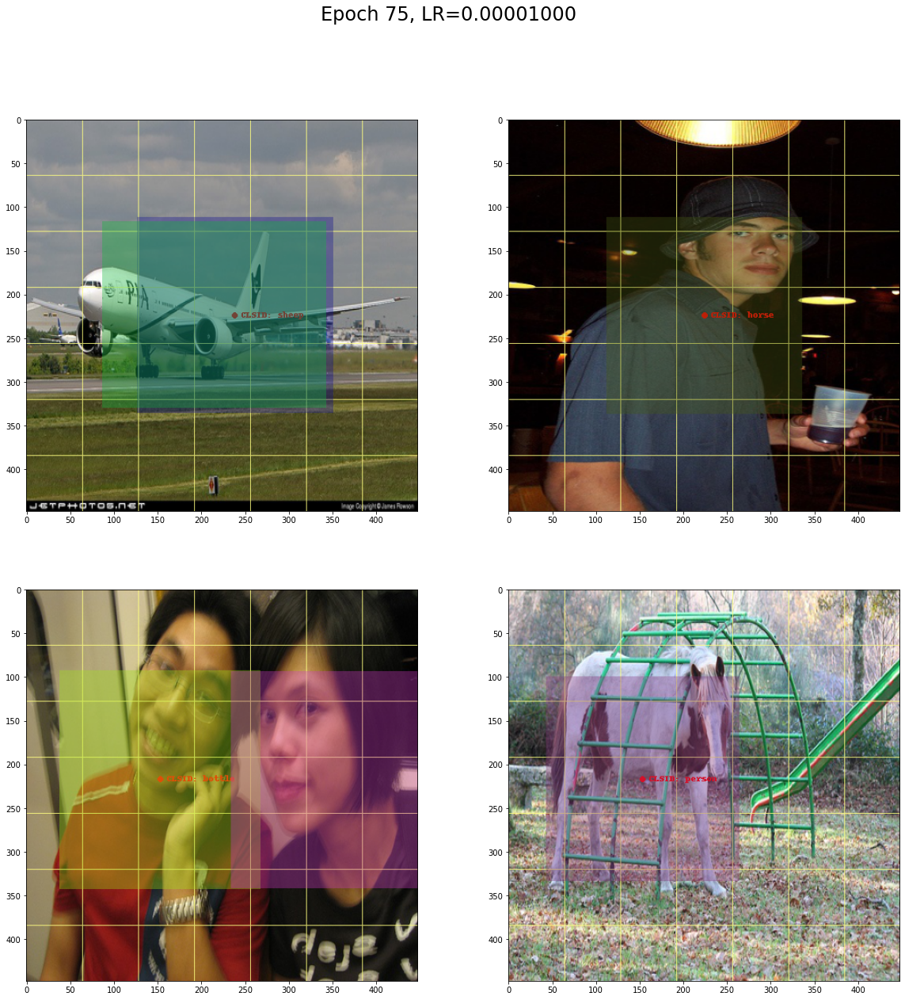

Epoch 75: Loss 11.085935 Acc 0.200000 AccT5 0.600000
Epoch 76: Loss 11.757154 Acc 0.200000 AccT5 0.600000
Epoch 77: Loss 11.674918 Acc 0.200000 AccT5 0.600000
Epoch 78: Loss 10.673748 Acc 0.200000 AccT5 0.600000
Epoch 79: Loss 11.041196 Acc 0.200000 AccT5 0.600000
Epoch 80: Loss 11.259883 Acc 0.200000 AccT5 0.600000
Epoch 81: Loss 10.615486 Acc 0.200000 AccT5 0.600000
Epoch 82: Loss 11.083845 Acc 0.200000 AccT5 0.600000
Epoch 83: Loss 10.802236 Acc 0.200000 AccT5 0.600000
Epoch 84: Loss 10.758564 Acc 0.200000 AccT5 0.600000
Epoch 85: Loss 10.919615 Acc 0.200000 AccT5 0.600000
Epoch 86: Loss 10.630606 Acc 0.200000 AccT5 0.600000
Epoch 87: Loss 10.889913 Acc 0.200000 AccT5 0.600000
Epoch 88: Loss 10.620818 Acc 0.200000 AccT5 0.600000
Epoch 89: Loss 10.814384 Acc 0.200000 AccT5 0.600000
Epoch 90: Loss 10.641201 Acc 0.200000 AccT5 0.600000
Epoch 91: Loss 10.746840 Acc 0.200000 AccT5 0.600000
Epoch 92: Loss 10.658829 Acc 0.200000 AccT5 0.600000
Epoch 93: Loss 10.693711 Acc 0.200000 AccT5 0.

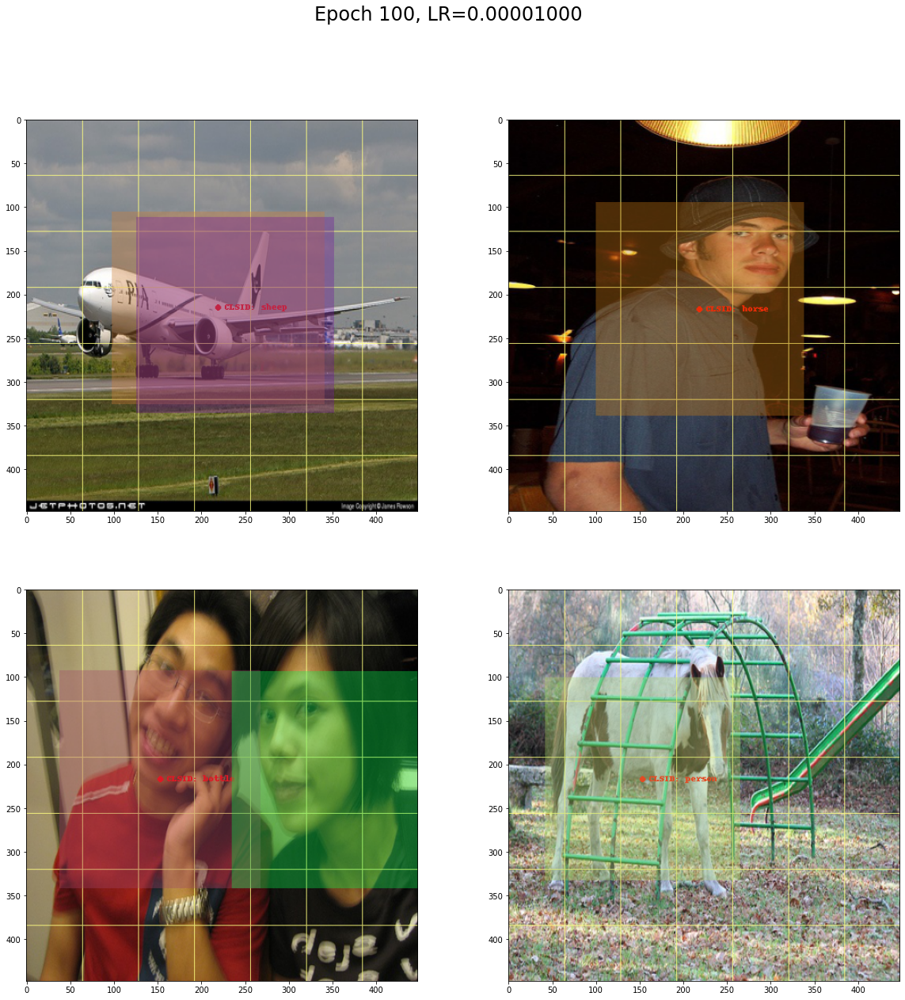

Epoch 100: Loss 10.656583 Acc 0.200000 AccT5 0.600000
Epoch 101: Loss 10.610885 Acc 0.200000 AccT5 0.600000
Epoch 102: Loss 10.648672 Acc 0.200000 AccT5 0.600000
Epoch 103: Loss 10.604172 Acc 0.200000 AccT5 0.600000
Epoch 104: Loss 10.639545 Acc 0.200000 AccT5 0.600000
Epoch 105: Loss 10.599856 Acc 0.200000 AccT5 0.600000
Epoch 106: Loss 10.630295 Acc 0.200000 AccT5 0.600000
Epoch 107: Loss 10.597755 Acc 0.200000 AccT5 0.600000
Epoch 108: Loss 10.620740 Acc 0.200000 AccT5 0.600000
Epoch 109: Loss 10.597374 Acc 0.200000 AccT5 0.600000
Epoch 110: Loss 10.610461 Acc 0.200000 AccT5 0.600000
Epoch 111: Loss 10.598221 Acc 0.200000 AccT5 0.600000
Epoch 112: Loss 10.601136 Acc 0.200000 AccT5 0.600000
Epoch 113: Loss 10.598997 Acc 0.200000 AccT5 0.600000
Epoch 114: Loss 10.593222 Acc 0.200000 AccT5 0.600000
Epoch 115: Loss 10.598573 Acc 0.200000 AccT5 0.600000
Epoch 116: Loss 10.587818 Acc 0.200000 AccT5 0.600000
Epoch 117: Loss 10.596256 Acc 0.200000 AccT5 0.600000
Epoch 118: Loss 10.585473 Ac

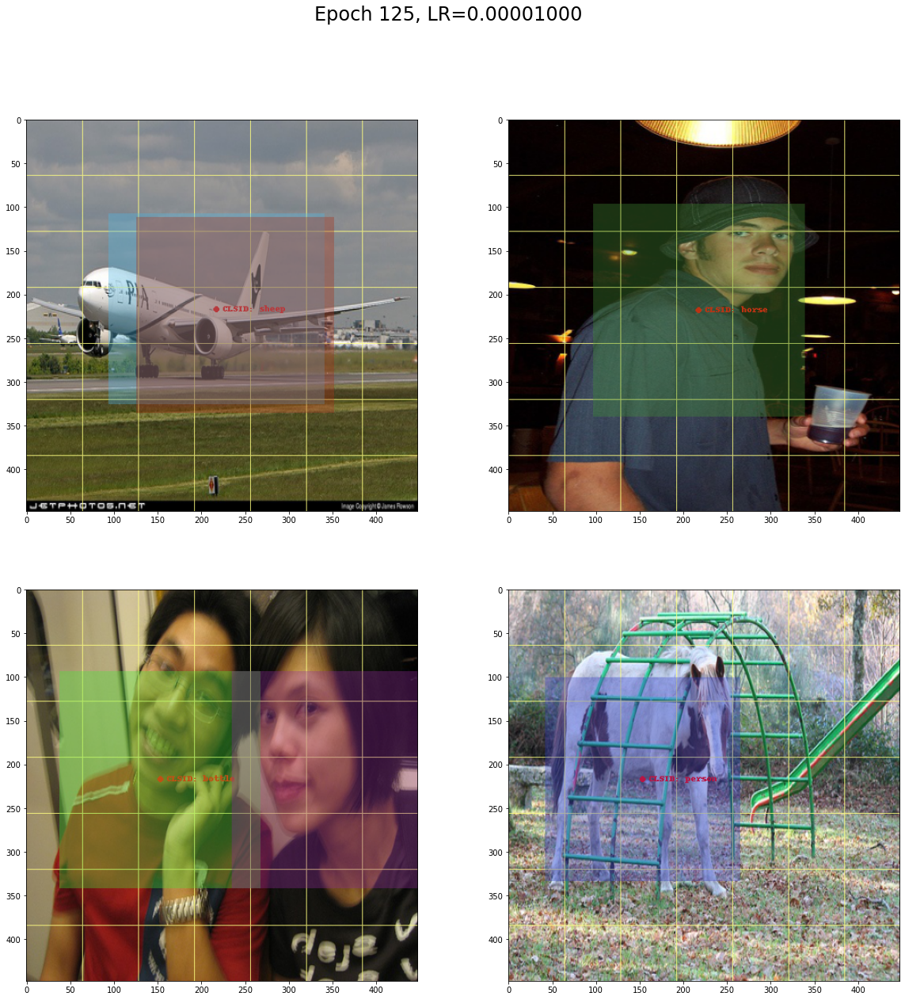

Epoch 125: Loss 10.579905 Acc 0.200000 AccT5 0.600000
Epoch 126: Loss 10.581845 Acc 0.200000 AccT5 0.600000
Epoch 127: Loss 10.580555 Acc 0.200000 AccT5 0.600000
Epoch 128: Loss 10.578027 Acc 0.200000 AccT5 0.600000
Epoch 129: Loss 10.580224 Acc 0.200000 AccT5 0.600000
Epoch 130: Loss 10.576754 Acc 0.200000 AccT5 0.600000
Epoch 131: Loss 10.577487 Acc 0.200000 AccT5 0.600000
Epoch 132: Loss 10.577295 Acc 0.200000 AccT5 0.600000
Epoch 133: Loss 10.574945 Acc 0.200000 AccT5 0.600000
Epoch 134: Loss 10.576303 Acc 0.200000 AccT5 0.600000
Epoch 135: Loss 10.574799 Acc 0.200000 AccT5 0.600000
Epoch 136: Loss 10.573879 Acc 0.200000 AccT5 0.600000
Epoch 137: Loss 10.574761 Acc 0.200000 AccT5 0.600000
Epoch 138: Loss 10.573093 Acc 0.200000 AccT5 0.600000
Epoch 139: Loss 10.572841 Acc 0.200000 AccT5 0.600000
Epoch 140: Loss 10.573278 Acc 0.200000 AccT5 0.600000
Epoch 141: Loss 10.571900 Acc 0.200000 AccT5 0.600000
Epoch 142: Loss 10.571788 Acc 0.200000 AccT5 0.600000
Epoch 143: Loss 10.572060 Ac

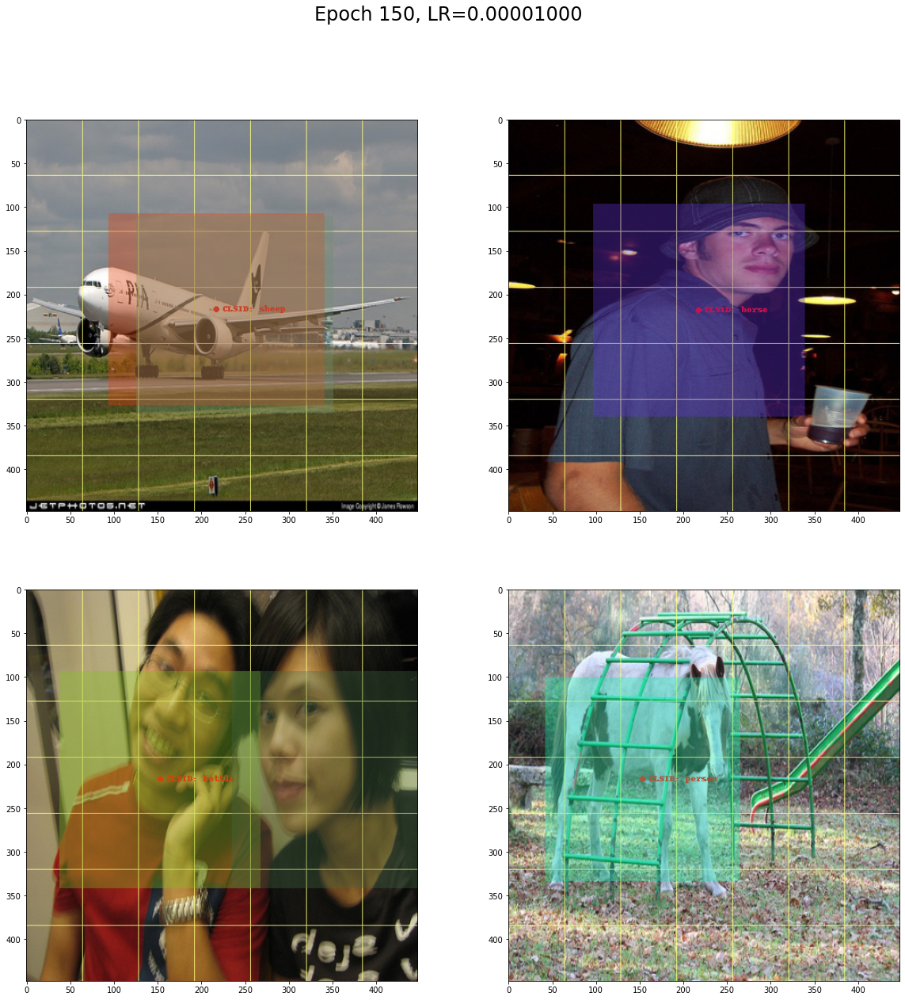

Epoch 150: Loss 10.569707 Acc 0.200000 AccT5 0.600000
Epoch 151: Loss 10.569188 Acc 0.200000 AccT5 0.600000
Epoch 152: Loss 10.569324 Acc 0.200000 AccT5 0.600000
Epoch 153: Loss 10.569528 Acc 0.200000 AccT5 0.600000
Epoch 154: Loss 10.569775 Acc 0.200000 AccT5 0.600000
Epoch 155: Loss 10.571574 Acc 0.200000 AccT5 0.600000
Epoch 156: Loss 10.577550 Acc 0.200000 AccT5 0.600000
Epoch 157: Loss 10.594214 Acc 0.200000 AccT5 0.600000
Epoch 158: Loss 10.636986 Acc 0.200000 AccT5 0.600000
Epoch 159: Loss 10.728405 Acc 0.200000 AccT5 0.600000
Epoch 160: Loss 10.863801 Acc 0.200000 AccT5 0.600000
Epoch 161: Loss 10.961021 Acc 0.200000 AccT5 0.600000
Epoch 162: Loss 10.889608 Acc 0.200000 AccT5 0.600000
Epoch 163: Loss 10.730331 Acc 0.200000 AccT5 0.600000
Epoch 164: Loss 10.712667 Acc 0.200000 AccT5 0.600000
Epoch 165: Loss 10.771852 Acc 0.200000 AccT5 0.600000
Epoch 166: Loss 10.684283 Acc 0.200000 AccT5 0.600000
Epoch 167: Loss 10.615477 Acc 0.200000 AccT5 0.600000
Epoch 168: Loss 10.702073 Ac

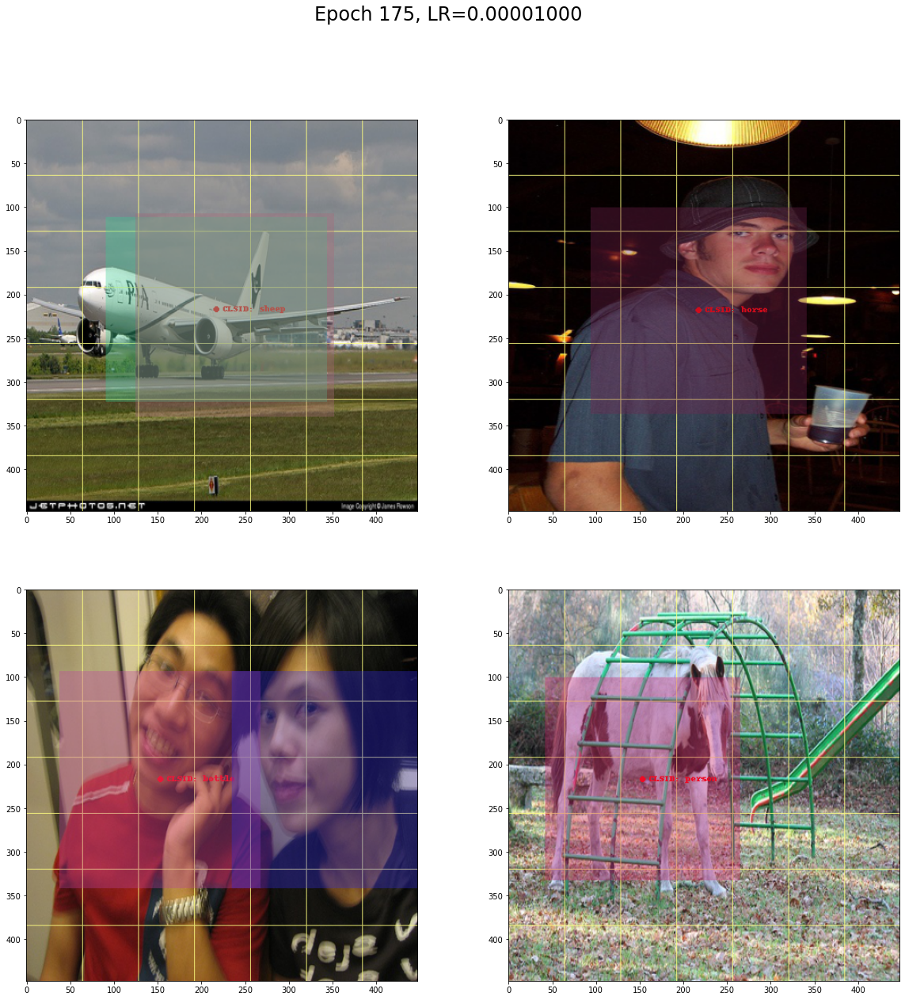

Epoch 175: Loss 10.620857 Acc 0.200000 AccT5 0.600000
Epoch 176: Loss 10.575603 Acc 0.200000 AccT5 0.600000
Epoch 177: Loss 10.620322 Acc 0.200000 AccT5 0.600000
Epoch 178: Loss 10.596728 Acc 0.200000 AccT5 0.600000
Epoch 179: Loss 10.581711 Acc 0.200000 AccT5 0.600000
Epoch 180: Loss 10.607171 Acc 0.200000 AccT5 0.600000
Epoch 181: Loss 10.581655 Acc 0.200000 AccT5 0.600000
Epoch 182: Loss 10.588263 Acc 0.200000 AccT5 0.600000
Epoch 183: Loss 10.592621 Acc 0.200000 AccT5 0.600000
Epoch 184: Loss 10.576537 Acc 0.200000 AccT5 0.600000
Epoch 185: Loss 10.590074 Acc 0.200000 AccT5 0.600000
Epoch 186: Loss 10.580671 Acc 0.200000 AccT5 0.600000
Epoch 187: Loss 10.577237 Acc 0.200000 AccT5 0.600000
Epoch 188: Loss 10.586664 Acc 0.200000 AccT5 0.600000
Epoch 189: Loss 10.574027 Acc 0.200000 AccT5 0.600000
Epoch 190: Loss 10.578634 Acc 0.200000 AccT5 0.600000
Epoch 191: Loss 10.581155 Acc 0.200000 AccT5 0.600000
Epoch 192: Loss 10.571773 Acc 0.200000 AccT5 0.600000
Epoch 193: Loss 10.578334 Ac

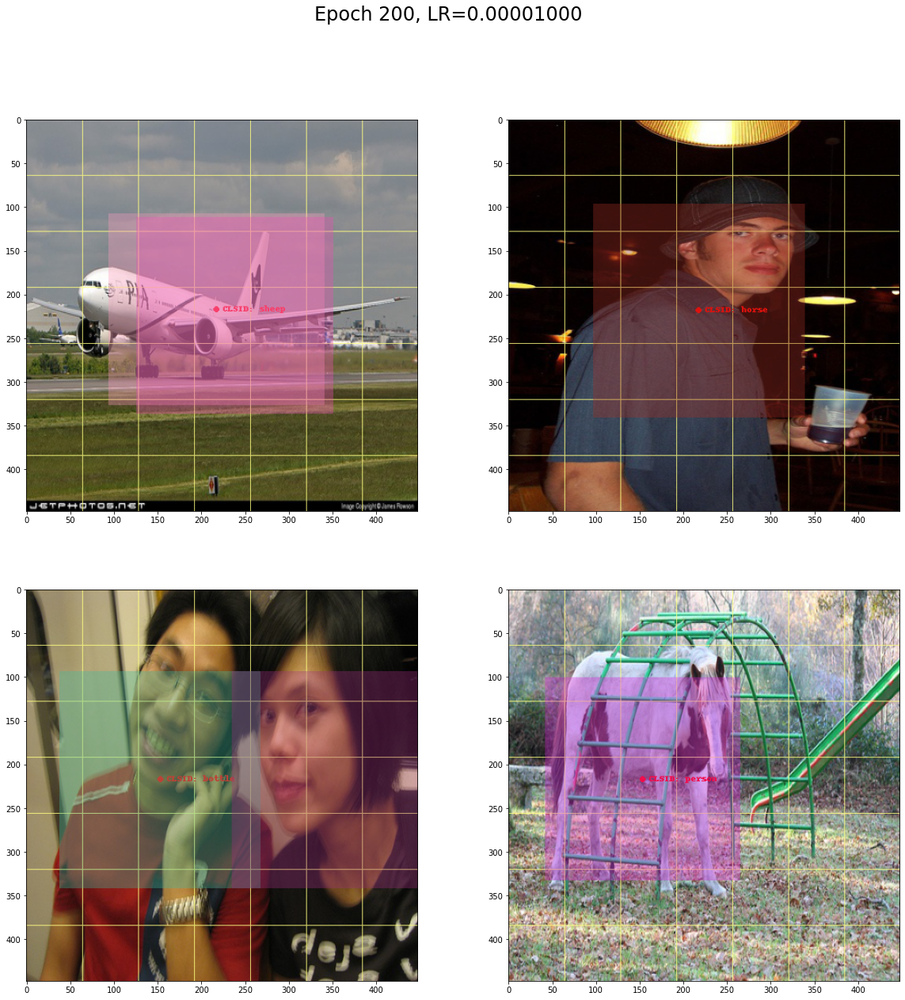

Epoch 200: Loss 10.571473 Acc 0.200000 AccT5 0.600000
Epoch 201: Loss 10.571296 Acc 0.200000 AccT5 0.600000
Epoch 202: Loss 10.572296 Acc 0.200000 AccT5 0.600000
Epoch 203: Loss 10.570162 Acc 0.200000 AccT5 0.600000
Epoch 204: Loss 10.570714 Acc 0.200000 AccT5 0.600000
Epoch 205: Loss 10.570986 Acc 0.200000 AccT5 0.600000
Epoch 206: Loss 10.569186 Acc 0.200000 AccT5 0.600000
Epoch 207: Loss 10.569740 Acc 0.200000 AccT5 0.600000
Epoch 208: Loss 10.570072 Acc 0.200000 AccT5 0.600000
Epoch 209: Loss 10.568632 Acc 0.200000 AccT5 0.600000
Epoch 210: Loss 10.568695 Acc 0.200000 AccT5 0.600000
Epoch 211: Loss 10.569122 Acc 0.200000 AccT5 0.600000
Epoch 212: Loss 10.568283 Acc 0.200000 AccT5 0.600000
Epoch 213: Loss 10.567965 Acc 0.200000 AccT5 0.600000
Epoch 214: Loss 10.568180 Acc 0.200000 AccT5 0.600000
Epoch 215: Loss 10.567802 Acc 0.200000 AccT5 0.600000
Epoch 216: Loss 10.567486 Acc 0.200000 AccT5 0.600000
Epoch 217: Loss 10.567510 Acc 0.200000 AccT5 0.600000
Epoch 218: Loss 10.567247 Ac

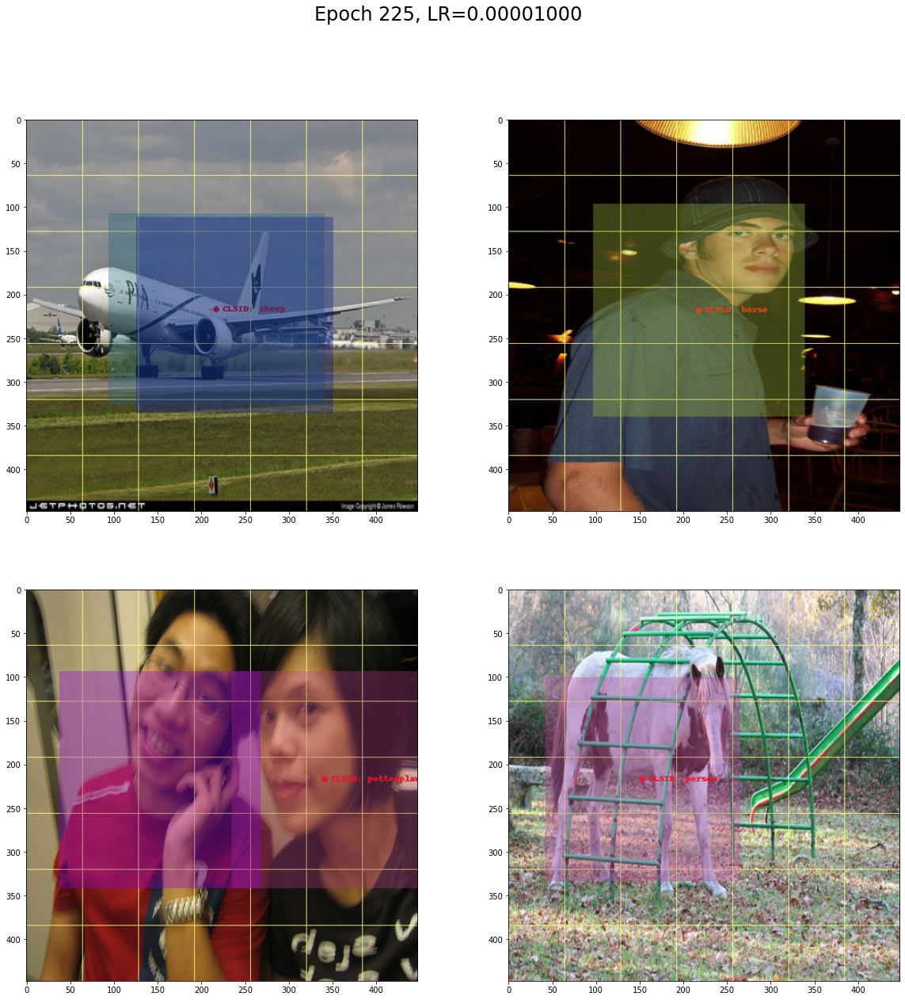

Epoch 225: Loss 10.566264 Acc 0.200000 AccT5 0.600000
Epoch 226: Loss 10.566100 Acc 0.200000 AccT5 0.600000
Epoch 227: Loss 10.565946 Acc 0.200000 AccT5 0.600000
Epoch 228: Loss 10.565832 Acc 0.200000 AccT5 0.600000
Epoch 229: Loss 10.565724 Acc 0.200000 AccT5 0.600000
Epoch 230: Loss 10.565613 Acc 0.200000 AccT5 0.600000
Epoch 231: Loss 10.565514 Acc 0.200000 AccT5 0.600000
Epoch 232: Loss 10.565447 Acc 0.200000 AccT5 0.600000
Epoch 233: Loss 10.565408 Acc 0.200000 AccT5 0.600000
Epoch 234: Loss 10.565372 Acc 0.200000 AccT5 0.600000
Epoch 235: Loss 10.565344 Acc 0.200000 AccT5 0.600000
Epoch 236: Loss 10.565414 Acc 0.200000 AccT5 0.600000
Epoch 237: Loss 10.565765 Acc 0.200000 AccT5 0.600000
Epoch 238: Loss 10.566736 Acc 0.000000 AccT5 0.600000
Epoch 239: Loss 10.569162 Acc 0.200000 AccT5 0.600000
Epoch 240: Loss 10.575384 Acc 0.000000 AccT5 0.600000
Epoch 241: Loss 10.591642 Acc 0.000000 AccT5 0.600000
Epoch 242: Loss 10.634446 Acc 0.000000 AccT5 0.600000
Epoch 243: Loss 10.742314 Ac

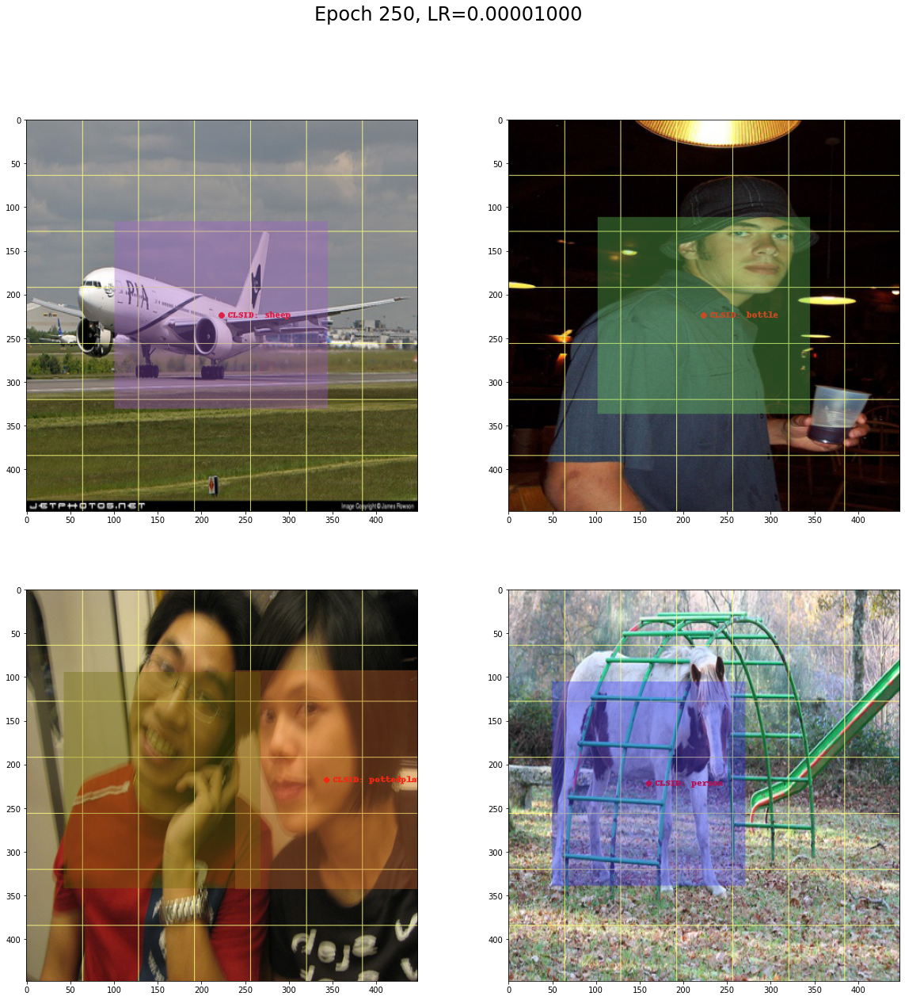

Epoch 250: Loss 12.485579 Acc 0.400000 AccT5 0.600000
Epoch 251: Loss 13.792977 Acc 0.600000 AccT5 0.600000
Epoch 252: Loss 15.625999 Acc 0.600000 AccT5 0.600000


KeyboardInterrupt: 

In [9]:
from time import sleep

# Testing loss with given pseudo output!
criterion = YoloLoss(lambda_coord=5, lambda_noobj=0.5, debug=False)
optimizer = torch.optim.Adam(model.parameters(), lr=0.00001)

# batched_image = torch.cat([image for image, label in bunch_of_batch], 0)
# batched_label = torch.cat([label for image, label in bunch_of_batch], 0)

losses = []
class_accuracies = []
class_top_5_accuracies = []

batched_image = torch.cat([image for (image, label) in bunch_of_batch], 0)
batched_label = torch.cat([label for (image, label) in bunch_of_batch], 0)

print(batched_image.shape)
print(batched_label.shape)

for epoch in range(1000):
#     random.shuffle(bunch_of_batch)

    if epoch % 25 == 0:
        do_visualization(title="Epoch %d, LR=%.8f" % (epoch, optimizer.param_groups[0]['lr']), confidence_threshold=0.4)
        
    if batched_image.device.type != 'cuda':
        batched_image = batched_image.cuda(non_blocking=True)
        batched_label = batched_label.cuda(non_blocking=True)
        
    output = model(batched_image)
    loss = criterion(output, batched_label)
    loss.backward()
    optimizer.step()
    optimizer.zero_grad(set_to_none=True)

    with torch.no_grad():
        model.eval()
        class_accuracy = torch.sum(
            torch.eq(
                torch.argmax(torch.sigmoid(output[:, -20:, :, :]), dim=1),
                torch.argmax(batched_label, dim=1)
            ) * (batched_label[:, 4, :, :] == 1)
        ) / torch.sum(batched_label[:, 4:5, :, :])
        class_top_5_accuracy = torch.sum(
            torch.any(
                torch.eq(
                    torch.argsort(torch.sigmoid(output[:, -20:, :, :]), dim=1)[:, -5:, :, :],
                    torch.argmax(batched_label, dim=1, keepdim=True).repeat(1, 5, 1, 1)
                ),
                dim=1
            ) * (batched_label[:, 4, :, :] == 1)
        ) / torch.sum(batched_label[:, 4:5, :, :])
        losses.append(loss.item())
        class_accuracies.append(class_accuracy.item())
        class_top_5_accuracies.append(class_top_5_accuracy.item())
        print("Epoch %d: Loss %.6f Acc %.6f AccT5 %.6f" % (epoch, losses[-1], class_accuracies[-1], class_top_5_accuracies[-1]))
        model.train()

#     output = model(batched_image)
#     loss = criterion(output, batched_label)
#     loss.backward()
#     optimizer.step()
#     optimizer.zero_grad(set_to_none=True)

#     with torch.no_grad():
#         losses.append(loss.item())